## Olist E-Commerce Dataset 

## Business Understanding

This dataset was generously provided by Olist, the largest department store in Brazilian marketplaces. Olist connects small businesses from all over Brazil to channels without hassle and with a single contract. Those merchants are able to sell their products through the Olist Store and ship them directly to the customers using Olist logistics partners.

In [87]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
import seaborn as sns
from datetime import datetime 
%matplotlib inline


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


## Gathering Data

In [ ]:
df=pd.read_csv(".\olist_orders_dataset.csv")
df_seller=pd.read_csv(".\olist_sellers_dataset.csv")
df_products=pd.read_csv(".\olist_products_dataset.csv")
df_customer=pd.read_csv(".\olist_customers_dataset.csv")
df_reviews=pd.read_csv(".\olist_order_reviews_dataset.csv")
df_prodcat=pd.read_csv(".\product_category_name_translation.csv")
df_payment=pd.read_csv(".\olist_order_payments_dataset.csv")
df_items=pd.read_csv(".\olist_order_items_dataset.csv")
df.head()

## Data Preparation

In [88]:
# Checking for missing values.
df.isnull().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64

In [90]:
#Droping rows with missing values.
df = df.dropna(axis=0, how='any')

In [91]:
#Percent of missing values ~3%, so dropping was fine. Further it would not make too much sense to impute those values.
df.shape

(96461, 8)

In [ ]:
def convert_to_dt(dat, cols):
    '''Function takes in a dataframe name and date columns for conversion into datetime format'''
    for col in cols:
        dat[col] = pd.to_datetime(dat[col]).dt.date

In [ ]:
convert_to_dt(df_orders, ['order_purchase_timestamp', 'order_delivered_customer_date', 'order_estimated_delivery_date', 'order_approved_at'])

In [93]:
#Splitting the timestamps into a new date column 
#df['purchase_date'] = pd.to_datetime(df['order_purchase_timestamp']).dt.date
#df['customer_date'] = pd.to_datetime(df['order_delivered_customer_date']).dt.date
#df['estimated_delivery_date'] = pd.to_datetime(df['order_estimated_delivery_date']).dt.date
#df['approved_at'] = pd.to_datetime(df['order_approved_at']).dt.date

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,purchase_date,customer_date,estimated_delivery_date,approved_at
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,2017-10-02,2017-10-10,2017-10-18,2017-10-02
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,2018-07-24,2018-08-07,2018-08-13,2018-07-26
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,2018-08-08,2018-08-17,2018-09-04,2018-08-08
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,2017-11-18,2017-12-02,2017-12-15,2017-11-18
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,2018-02-13,2018-02-16,2018-02-26,2018-02-13


In [94]:
#Droping the timestamp columns as those are not of interest for me right now.
#df_orders = df.drop(["order_purchase_timestamp", "order_approved_at", "order_delivered_carrier_date", "order_delivered_customer_date", "order_estimated_delivery_date"], axis=1)

,order_id,customer_id,order_status,purchase_date,customer_date,estimated_delivery_date,approved_at
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02,2017-10-10,2017-10-18,2017-10-02
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24,2018-08-07,2018-08-13,2018-07-26
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08,2018-08-17,2018-09-04,2018-08-08
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18,2017-12-02,2017-12-15,2017-11-18
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13,2018-02-16,2018-02-26,2018-02-13


In [95]:
#Checking the datatypes
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96461 entries, 0 to 99440
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   order_id                 96461 non-null  object
 1   customer_id              96461 non-null  object
 2   order_status             96461 non-null  object
 3   purchase_date            96461 non-null  object
 4   customer_date            96461 non-null  object
 5   estimated_delivery_date  96461 non-null  object
 6   approved_at              96461 non-null  object
dtypes: object(7)
memory usage: 5.9+ MB


In [96]:
#Changing the date columns from object to datetime (keep in mind ns= nano seconds!)
df_orders[["purchase_date", "customer_date", "estimated_delivery_date", "approved_at"]] = df[["purchase_date", "customer_date", "estimated_delivery_date", "approved_at"]].apply(pd.to_datetime)

In [97]:
#Checking the data types
df_orders["order_delay"]=df_orders["customer_date"]-df_orders["estimated_delivery_date"]  

In [98]:
df_orders["order_duration"]=df_orders["customer_date"]-df_orders["purchase_date"]  
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96461 entries, 0 to 99440
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype          
---  ------                   --------------  -----          
 0   order_id                 96461 non-null  object         
 1   customer_id              96461 non-null  object         
 2   order_status             96461 non-null  object         
 3   purchase_date            96461 non-null  datetime64[ns] 
 4   customer_date            96461 non-null  datetime64[ns] 
 5   estimated_delivery_date  96461 non-null  datetime64[ns] 
 6   approved_at              96461 non-null  datetime64[ns] 
 7   order_delay              96461 non-null  timedelta64[ns]
 8   order_duration           96461 non-null  timedelta64[ns]
dtypes: datetime64[ns](4), object(3), timedelta64[ns](2)
memory usage: 7.4+ MB


In [99]:
#Checking for duplicated entries
print('Total of unique orders: ', format(len(df_orders['order_id'].unique())))
print('Total of records: ', format(len(df_orders)))

Total of unique orders:  96461
Total of records:  96461


In [101]:
df_orders.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
order_delay,96461,-12 days +02:59:10.176755,10 days 04:24:12.308640,-147 days,-17 days,-12 days,-7 days,188 days
order_duration,96461,12 days 11:55:22.781227,9 days 13:19:37.720878,0 days,7 days,10 days,16 days,210 days


In [102]:
#Taking care of the ns format for further processing
df_orders["order_delay"] = pd.to_timedelta(df_orders["order_delay"], unit='ns').dt.days
df_orders["order_duration"] = pd.to_timedelta(df_orders["order_duration"], unit='ns').dt.days

(-60, 60)

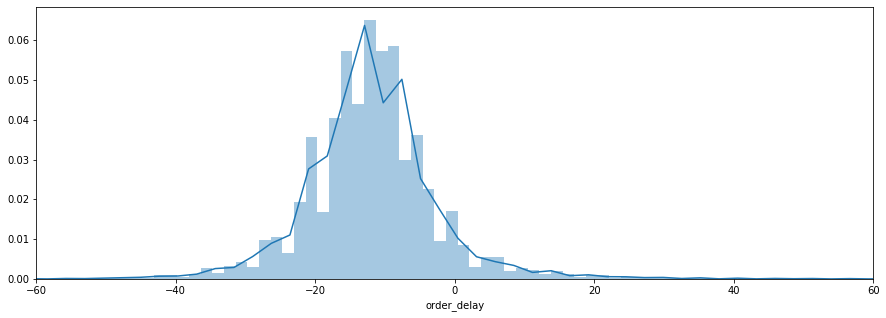

In [103]:
plt.figure(figsize=(15,5))
sns.distplot(df_orders["order_delay"], hist=True, kde=True, bins=200)
plt.xlim(-60,60)


In [104]:
df_orders["order_duration"].mean()

12.496791449394056

(0, 60)

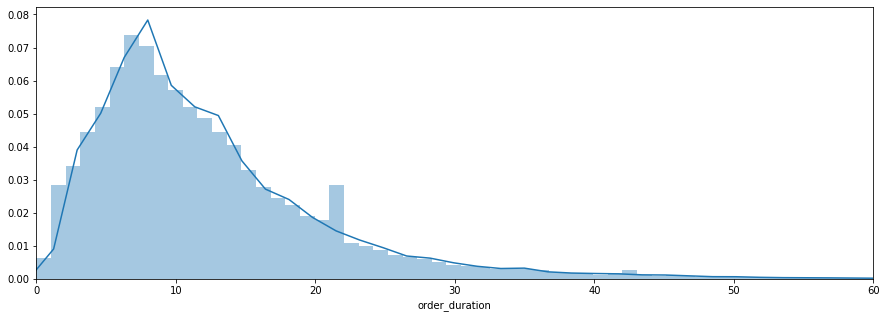

In [105]:
plt.figure(figsize=(15,5))
sns.distplot(df_orders["order_duration"], hist=True, kde=True, bins=200)
plt.xlim(0,60)

### Seems like quite a normal distribution. Olist's estimated delivery seems to include some safety...
Let's take a look at the other datasets now:
- df_seller
- df_products
- df_customer
- df_reviews
- df_prodcat

In [106]:
df_products.head() #It's all about dimensions!

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [107]:
#Checking the data types
df_products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


In [108]:
df_prodcat.head() #English explanation for the the category name. Let's get going.

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [109]:
df_payment.head() #price per order. We will take a look at it later.

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [110]:
df_items.head() #prices per item

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


At first I'd like to dive deeper into the orders + items. Therefore I will clean up the df_items before merging those two tables for further processing.

Again: Let's check and clean our data ...

In [111]:
df_items.isnull().sum() #no missing values

order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0
dtype: int64

In [112]:
df_items.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
order_item_id,112650.0,1.197834,0.705124,1.00,1.00,1.00,1.00,21.00
price,112650.0,120.653739,183.633928,0.85,39.90,74.99,134.90,6735.00
freight_value,112650.0,19.990320,15.806405,0.00,13.08,16.26,21.15,409.68


The avarage order is a single item order around 74,99 Real.

In [113]:
#Checking how many unique orders are listed
print('Total of unique orders in order_items table: ', format(len(df_items['order_id'].unique())))
print('Total of unique orders in order table: ', format(len(df_orders['order_id'].unique())))
print('Total of records in order_items: ', format(len(df_items)))
print("Total of records in order table:", format(len(df_orders)))

Total of unique orders in order_items table:  98666
Total of unique orders in order table:  96461
Total of records in order_items:  112650
Total of records in order table: 96461


There are a few entries multiple times in the order_items table. Let's take a look at that:

In [114]:
# Checking duplicate entries and duplicate order lines:
print('Number of duplcated records: ', format(df_items.duplicated().sum()))
print('Number of duplcated orders: ', format(df_items[['order_id']].duplicated().sum()))
print('Number of duplcated products: ', format(df_items[['product_id']].duplicated().sum()))
print('Number of duplcated order lines: ', format(df_items[['order_id', 'product_id']].duplicated().sum()))

Number of duplcated records:  0
Number of duplcated orders:  13984
Number of duplcated products:  79699
Number of duplcated order lines:  10225


The order_items has one row per item. Although the huge majority consists of 1 item per order, there are some orders which consist of x items and those have x rows with the same order_id.

In [115]:
# Grouping by order ID to get an understanding of the orders (items, price, freight value per order and not per product):
df_items_con = df_items.groupby(by= ['order_id']).agg({'order_item_id':'count', 'product_id': 'first','seller_id':'first', 'shipping_limit_date': 'first', 'price': 'sum', 'freight_value': 'sum'}).reset_index()

In [116]:
# Checking if the groupby was done correctly: Grouped if the order_id is identical. Show the first product. Count the item id to see how many items are within the order. Summ the price to have the order price. Summ the fright value.
df_items_con[df_items_con['order_item_id'] == 4]

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
124,00526a9d4ebde463baee25f386963ddc,4,0c4a0f8ab44f9acd2d04e7024f9ba362,7210cd29727d674c00741e5e387b3ccd,2018-08-14 22:15:22,135.56,33.60
268,00bcee890eba57a9767c7b5ca12d3a1b,4,6c90c0f6c2d89eb816b9e205b9d6a36a,3bb548e3cb7f70f28e3f11ee9dce0e59,2017-07-26 21:05:07,672.41,100.09
294,00c9f7d4b0e87781465e562dc109f6aa,4,1a0d662b65b5ef08796501b064c853af,2e0dba2da448400b1c11d7b4b22f32a4,2017-05-26 19:25:17,59.96,60.40
347,00f1cc7439ccb8671133776d1829faf5,4,2fd91ba79b5f4f8342b67bd79cb54b3f,a673821011d0cec28146ea42f5ab767f,2017-11-30 03:12:39,139.96,37.36
389,010b143d83a59b355cd5a75c0f0fd785,4,6ff1fc9209c7854704a4f75c9fac41b4,4e922959ae960d389249c378d1c939f5,2017-09-05 23:44:47,88.00,136.60
...,...,...,...,...,...,...,...
98311,ff0286485ce9c3f1d6ed22a4c7402060,4,41801d2ed5124923137ec39aeeea1e93,3be634553519fb6536a03e1358e9fdc7,2018-02-20 15:30:38,239.60,79.64
98339,ff14a3e36b78f407a4e8402572e4edfe,4,f5cb4f19ca215fb34aef190918d45f46,0d83f8e03188682112cc0d93523705cc,2018-01-25 13:14:45,355.60,64.24
98556,ffb2c3a5bb149a2f860e5d057096201f,4,683647534fe73616ae97d91a6ef253f4,49383af7ab774e4e8f3000f49c83dc4b,2018-05-10 20:30:46,220.00,91.88
98564,ffb9a9cd00c74c11c24aa30b3d78e03b,4,fec565c4e3ad965c73fb1a21bb809257,da8622b14eb17ae2831f4ac5b9dab84a,2017-03-22 17:20:21,529.60,77.35


In [117]:
#Check the amount of products that are ordered within 1 order, shows that 1 item per order is by far the most common way of shopping at olist.
df_items_con["order_item_id"].value_counts()

1     88863
2      7516
3      1322
4       505
5       204
6       198
7        22
10        8
8         8
12        5
11        4
9         3
20        2
14        2
15        2
13        1
21        1
Name: order_item_id, dtype: int64

In [118]:
print ("Single Item Orders make ", 88863/ len(df_items_con) * 100,"percent of the orders ")

Single Item Orders make  90.06445989499929 percent of the orders 


The distrubution is quite typical for the ecomm business. The biggest part are SIOs and only a few MIOs. Whereas the prices are relatively scattered with an avarage of 74,99 Real.

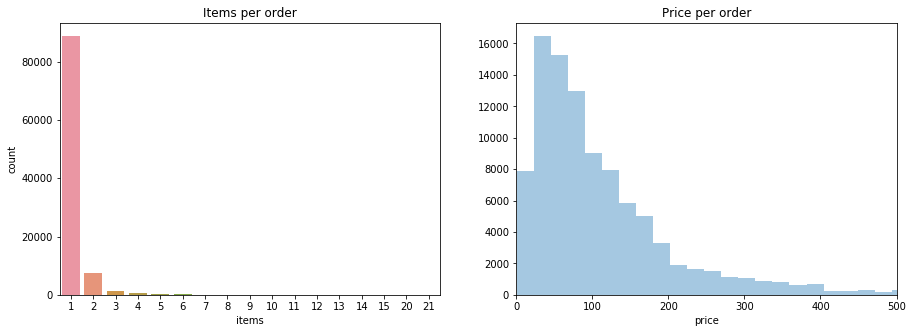

In [119]:
# Visualizing the distribution 
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (15, 5))
ax1.set_title("Items per order")

ax2.set_title("Price per order")
ax2.set_xlim([0,500])


sns.countplot(df_items_con['order_item_id'],
                ax=ax1);
ax1.set(xlabel="items")
#ax1.set_xlim([-0.5,21])

sns.distplot(df_items_con["price"],
                ax=ax2, kde=False, bins=600);

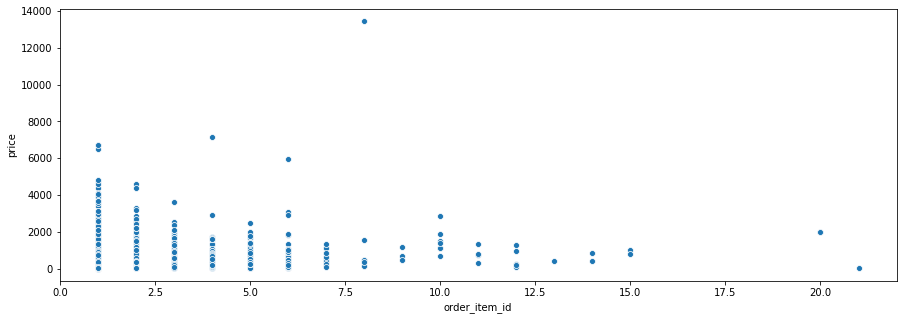

In [120]:
plt.figure(figsize=(15, 5))
sns.scatterplot(data = df_items_con,
                y = 'price',
                x = 'order_item_id')

## Taking a look at the payments

In [121]:
df_payment['payment_type'].value_counts()

credit_card    76795
boleto         19784
voucher         5775
debit_card      1529
not_defined        3
Name: payment_type, dtype: int64

In [122]:
df_payment['payment_type'].shape

(103886,)

In [123]:
#Checking for missing values
df_payment.isnull().sum()

order_id                0
payment_sequential      0
payment_type            0
payment_installments    0
payment_value           0
dtype: int64

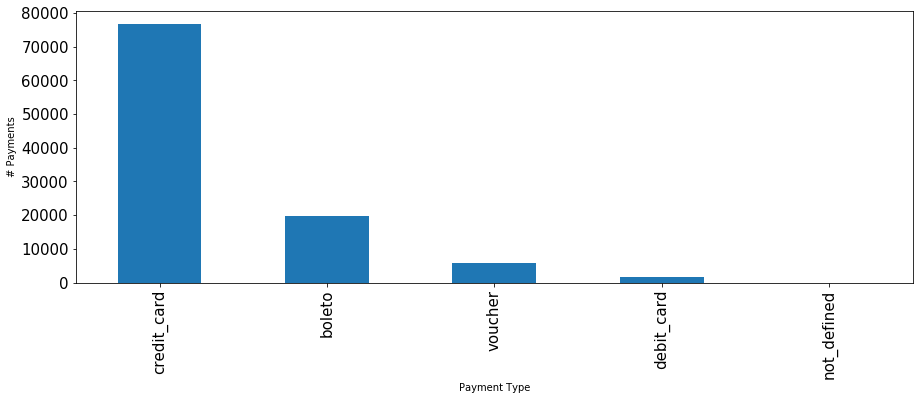

In [124]:
plt.xlabel('Payment Type')
plt.ylabel('# Payments')
df_payment['payment_type']\
    .value_counts()\
    .plot(kind = "bar", fontsize = 15, figsize = (15, 5))


#Note: Boleto means coupon

In [125]:
print('Total of unique orders in payment table: ', format(len(df_payment['order_id'].unique())))
print('Total of unique orders in consolidated items table: ', format(len(df_items_con['order_id'].unique())))

Total of unique orders in payment table:  99440
Total of unique orders in consolidated items table:  98666


As the following linear regression model can not handle categorical data we need to translate it into dummy columns "credit card" and comulate the others into "other payment"

In [126]:
# Create dummy variables per payment type (dummy_na = True would create a further nan column which is not necessary as we don't have any missing values in this column)
df_dummy_pay=pd.get_dummies(df_payment['payment_type'])
df_dummy_pay.head()

,boleto,credit_card,debit_card,not_defined,voucher
0,0,1,0,0,0
1,0,1,0,0,0
2,0,1,0,0,0
3,0,1,0,0,0
4,0,1,0,0,0


In [127]:
df_payment = df_payment.merge(df_dummy_pay, left_index=True, right_index=True)
df_payment.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value,boleto,credit_card,debit_card,not_defined,voucher
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33,0,1,0,0,0
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39,0,1,0,0,0
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71,0,1,0,0,0
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78,0,1,0,0,0
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45,0,1,0,0,0


## Creating combined table

To take a closer look at the order size and the payment method we will combine the following tables.

- df_items_con
- df_payment
- df_orders ["order_delay"]

In [128]:
    df_order_complete = df_items_con.merge(df_payment, on = 'order_id')

In [129]:
df_order_complete.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value,boleto,credit_card,debit_card,not_defined,voucher
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,1,credit_card,2,72.19,0,1,0,0,0
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,1,credit_card,3,259.83,0,1,0,0,0
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,1,credit_card,5,216.87,0,1,0,0,0
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,1,credit_card,2,25.78,0,1,0,0,0
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,1,credit_card,3,218.04,0,1,0,0,0


In [130]:
print('Total of unique orders: ', format(len(df_order_complete['order_id'].unique())))

Total of unique orders:  98665


In [131]:
#Dropping all columns exept the delay
df_orders_delay = df_orders.drop(["customer_id", "order_status","purchase_date", "customer_date","estimated_delivery_date","approved_at"], axis=1)
print('Total of unique orders: ', format(len(df_orders_delay['order_id'].unique())))
df_orders_delay.head()

Total of unique orders:  96461


,order_id,order_delay,order_duration
0,e481f51cbdc54678b7cc49136f2d6af7,-8,8
1,53cdb2fc8bc7dce0b6741e2150273451,-6,14
2,47770eb9100c2d0c44946d9cf07ec65d,-18,9
3,949d5b44dbf5de918fe9c16f97b45f8a,-13,14
4,ad21c59c0840e6cb83a9ceb5573f8159,-10,3


In [132]:
df_order_complete= df_order_complete.merge(df_orders_delay, on='order_id') 
print('Total of unique orders: ', format(len(df_order_complete['order_id'].unique())))

Total of unique orders:  96460


In [134]:
df_order_complete.describe()

,order_item_id,price,freight_value,payment_sequential,payment_installments,payment_value,boleto,credit_card,debit_card,not_defined,voucher,order_delay,order_duration
count,100739.000000,100739.000000,100739.000000,100739.000000,100739.000000,100739.000000,100739.000000,100739.000000,100739.000000,100739.0,100739.000000,100739.000000,100739.000000
mean,1.141743,137.100589,22.829925,1.088387,2.851894,153.065673,0.190363,0.740369,0.014741,0.0,0.054527,-11.892852,12.510517
std,0.535402,209.457796,21.510057,0.652783,2.684496,214.465614,0.392590,0.438434,0.120515,0.0,0.227056,10.186597,9.558757
min,1.000000,0.850000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,-147.000000,0.000000
25%,1.000000,45.900000,13.860000,1.000000,1.000000,56.780000,0.000000,0.000000,0.000000,0.0,0.000000,-17.000000,7.000000
50%,1.000000,85.990000,17.200000,1.000000,1.000000,100.000000,0.000000,1.000000,0.000000,0.0,0.000000,-12.000000,10.000000
75%,1.000000,149.900000,24.050000,1.000000,4.000000,171.290000,0.000000,1.000000,0.000000,0.0,0.000000,-7.000000,16.000000
max,21.000000,13440.000000,1794.960000,26.000000,24.000000,13664.080000,1.000000,1.000000,1.000000,0.0,1.000000,188.000000,210.000000


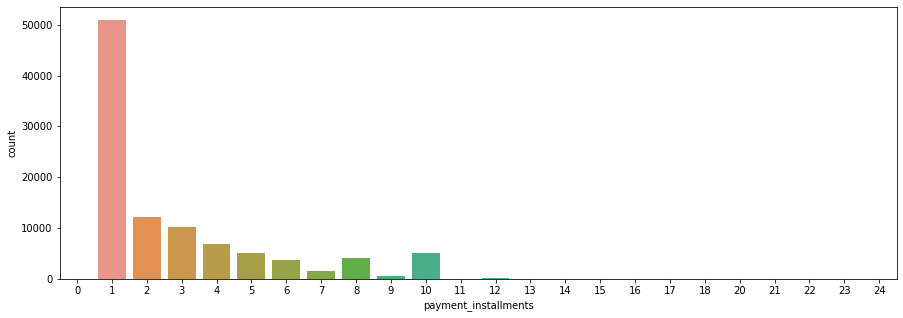

In [135]:
plt.figure(figsize= (15,5))
sns.countplot(df_order_complete["payment_installments"])

In [136]:
df_order_complete["payment_installments"].value_counts()

1     50912
2     12078
3     10163
4      6889
10     5150
5      5095
8      4136
6      3804
7      1563
9       618
12      128
15       72
18       27
11       22
24       18
20       16
13       15
14       14
17        7
16        5
21        3
0         2
23        1
22        1
Name: payment_installments, dtype: int64

In [138]:
df_order_complete.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100739 entries, 0 to 100738
Data columns (total 18 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              100739 non-null  object 
 1   order_item_id         100739 non-null  int64  
 2   product_id            100739 non-null  object 
 3   seller_id             100739 non-null  object 
 4   shipping_limit_date   100739 non-null  object 
 5   price                 100739 non-null  float64
 6   freight_value         100739 non-null  float64
 7   payment_sequential    100739 non-null  int64  
 8   payment_type          100739 non-null  object 
 9   payment_installments  100739 non-null  int64  
 10  payment_value         100739 non-null  float64
 11  boleto                100739 non-null  uint8  
 12  credit_card           100739 non-null  uint8  
 13  debit_card            100739 non-null  uint8  
 14  not_defined           100739 non-null  uint8  
 15  

In [139]:
df_order_complete=df_order_complete.drop(["not_defined"], axis=1)

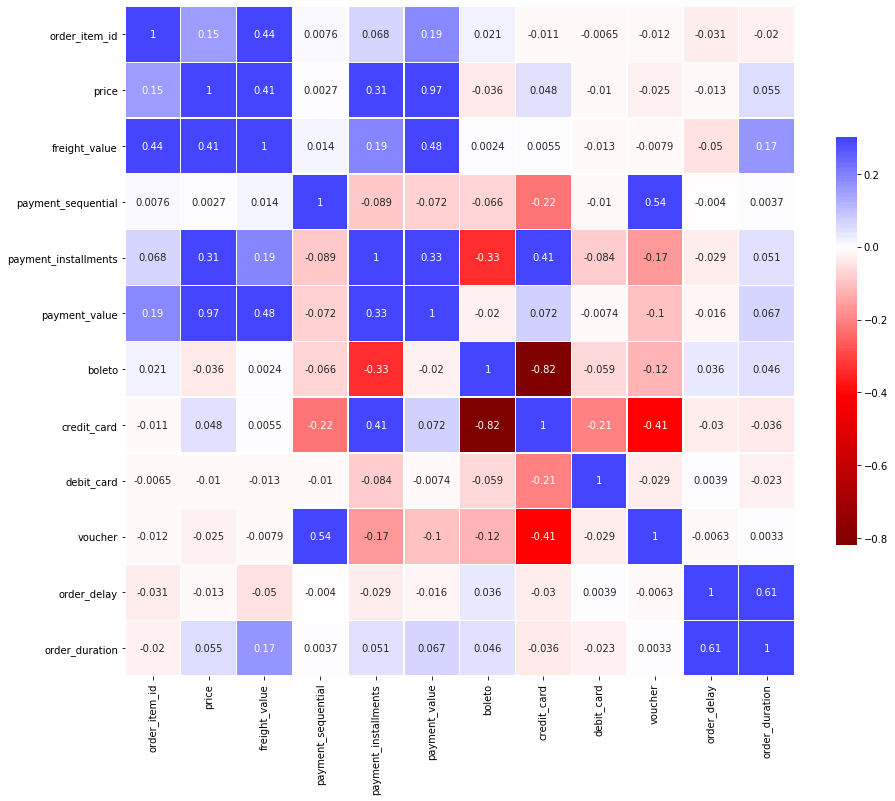

In [140]:
plt.figure(figsize = (15, 15))
sns.heatmap(df_order_complete.corr(),
            cmap = 'seismic_r',
            vmax = 0.3, center=0,
            square = True,
            linewidths = 0.5,
            cbar_kws = {"shrink": 0.5},
            annot = True);

There seems to be a correlation between the price of the order and 

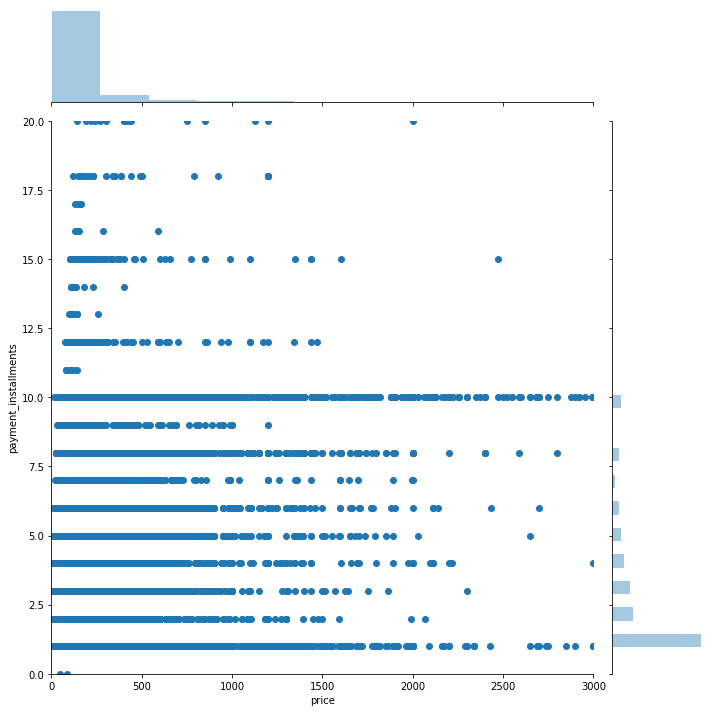

In [141]:
#plt.figure(figsize=(15,15))
sns.jointplot(data= df_order_complete, x= "price",y= "payment_installments", xlim=(0,3000), ylim=(0,20), height=10)


In [142]:
from sklearn.linear_model import LogisticRegression

#Split into explanatory and response variables
X = df_order_complete['payment_installments']
y = df_order_complete['voucher']

#Split into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = .50) 

lm_model = LogisticRegression() # Instantiate
lm_model.fit(np.array(X_train).reshape(-1,1), np.array(y_train).reshape(-1,1)) #Fit
        
#Predict and score the model
y_test_preds = lm_model.predict(np.array(X_test).reshape(-1,1))     

#Rsquared and y_test
rsquared_score = r2_score(y_test, y_test_preds) #r2_score
length_y_test = len(y_test) #num in y_test

In [143]:
rsquared_score

-0.058452275872824755